<a href="https://colab.research.google.com/github/mattyjr007/Data-Science-Portfolio/blob/master/carbon%20finance/xmathiasjr007_gmail_com.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### SQL

SELECT * ,case

when DATE_DIFF( CAST(paidAt AS DATE), CAST(dueDate AS DATE),day) > 7 then 1

when DATE_DIFF( CAST(paidAt AS DATE), CAST(dueDate AS DATE),day) is Null then 1

else 0

end as loanDefault

FROM `propane-highway-202915.arise.ChallengeLoanInfo` as Loan

join (with minDue as (

SELECT loanId ,min(dueDate) as minDueDate FROM  
`propane-highway-
202915.arise.ChallengeRepaymentsInfo`

group by loanId 
)

SELECT Rp.loanId as firstPaymentloanID ,RP.paymentRatio as firstPaymentRatio,CASE

when RP.settleDays  > 7  then 1 

when RP.settleDays  is Null then 1 

else 0

end as firstPaymentDefault

from minDue as MD

join `propane-highway-202915.arise.ChallengeRepaymentsInfo` as RP on 

MD.loanId  = RP.loanId 

WHERE MD.minDueDate  = RP.dueDate ) as RPCL on Loan.loanId  = 
RPCL.firstPaymentloanID

WHERE payout_status = 'SUCCESS' AND loanType = 'paylater' AND loanTerm in (60,90,180)

### DATA

In [ ]:
import matplotlib.pyplot as plt
!pip install --upgrade seaborn
import seaborn as sns
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
sns.set_style('darkgrid')
flatui = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c", "#34495e", "#2ecc71"]
sns.set_palette(flatui)
warnings.filterwarnings('ignore')
from tqdm import tqdm
# import require library

    100% |████████████████████████████████| 215kB 24.9MB/s 
  Found existing installation: seaborn 0.7.1
    Uninstalling seaborn-0.7.1:
      Successfully uninstalled seaborn-0.7.1


In [ ]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
  init_notebook_mode(connected=True)

In [ ]:
from plotly.offline import download_plotlyjs,  plot, iplot
get_ipython().events.register('pre_run_cell', enable_plotly_in_cell)
import cufflinks as cf
cf.go_offline()

In [ ]:
data = pd.read_csv('2019_3_11_a627af89-6e30-46f0-a0b1-c8a5e9b9060e.csv',nrows=159596) #load data

In [ ]:
data.head(2)

,clientId,clientIncome,incomeVerified,clientAge,clientGender,clientMaritalStatus,clientLoanPurpose,clientResidentialStauts,clientState,clientTimeAtEmployer,...,paidAt,loanAmount,interestRate,loanTerm,max_amount_taken,max_tenor_taken,firstPaymentloanID,firstPaymentRatio,firstPaymentDefault,loanDefault
0,755398623,52500.0,false,29,FEMALE,Single,business,Rented,KANO,7,...,2018-09-04 11:54:00 UTC,16000,20.0,60,1,1,302039538823,0.0,0,0
1,915689736,52500.0,false,25,MALE,Single,business,Rented,LAGOS,21,...,2018-09-06 04:44:04 UTC,14500,15.0,60,0,1,302251936174,0.0,0,0


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 159596 entries, 0 to 159595
Data columns (total 31 columns):
clientId                     159596 non-null int64
clientIncome                 159596 non-null float64
incomeVerified               159596 non-null object
clientAge                    159596 non-null int64
clientGender                 159596 non-null object
clientMaritalStatus          159596 non-null object
clientLoanPurpose            159596 non-null object
clientResidentialStauts      159596 non-null object
clientState                  159596 non-null object
clientTimeAtEmployer         159596 non-null object
clientNumberPhoneContacts    159596 non-null object
clientAvgCallsPerDay         159596 non-null object
loanId                       159596 non-null object
loanType                     159596 non-null object
loanNumber                   159596 non-null int64
applicationDate              159596 non-null object
approvalDate                 159596 non-null object
decline

In [ ]:
data.describe()

,clientId,clientIncome,clientAge,loanNumber,loanAmount,interestRate,loanTerm,max_amount_taken,max_tenor_taken,firstPaymentRatio,firstPaymentDefault,loanDefault
count,1.595960e+05,1.595960e+05,159596.000000,159596.000000,159596.000000,159596.000000,159596.000000,159596.000000,159596.000000,159596.000000,159596.000000,159596.000000
mean,4.980082e+08,9.083906e+04,33.691847,3.556806,35324.184190,13.331235,85.385599,0.705275,0.915374,0.097991,0.294268,0.279894
std,2.938655e+08,9.728033e+04,7.180870,2.471578,27840.824297,4.467938,39.323756,0.455921,0.278325,0.278058,0.455714,0.448948
min,5.060000e+02,3.000000e+01,18.000000,1.000000,11000.000000,4.500000,60.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.475166e+08,3.500000e+04,28.000000,2.000000,20000.000000,10.000000,60.000000,0.000000,1.000000,0.000000,0.000000,0.000000
50%,4.971904e+08,5.511621e+04,33.000000,3.000000,25500.000000,12.500000,60.000000,1.000000,1.000000,0.000000,0.000000,0.000000
75%,7.463713e+08,1.050000e+05,38.000000,4.000000,37500.000000,15.000000,90.000000,1.000000,1.000000,0.000000,1.000000,1.000000
max,9.365832e+09,3.925000e+06,138.000000,32.000000,500000.000000,20.000000,180.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [ ]:
data.replace('Null',np.NAN,inplace=True) # SQL MADE 'NULL LOOK LIKE A STRING SO CONVERT NULL TO NULL'

In [ ]:
data.isna().sum() # CHECK NUMBER OF NULL VALUES IN EACH COULMN

clientId                          0
clientIncome                      0
incomeVerified                  103
clientAge                         0
clientGender                      0
clientMaritalStatus               6
clientLoanPurpose                 0
clientResidentialStauts        1136
clientState                       1
clientTimeAtEmployer           4194
clientNumberPhoneContacts      2708
clientAvgCallsPerDay           2687
loanId                            0
loanType                          0
loanNumber                        0
applicationDate                   0
approvalDate                      0
declinedDate                 159589
disbursementDate                  0
payout_status                     0
dueDate                           0
paidAt                        29800
loanAmount                        0
interestRate                      0
loanTerm                          0
max_amount_taken                  0
max_tenor_taken                   0
firstPaymentloanID          

In [ ]:
data.drop(['firstPaymentloanID','clientId','loanId','payout_status','declinedDate'],axis=1,inplace=True)
#dropped irrelevant columns ,THIS COLUMNS WON'T BE NEEDED

### HANDLING MISSING VALUES

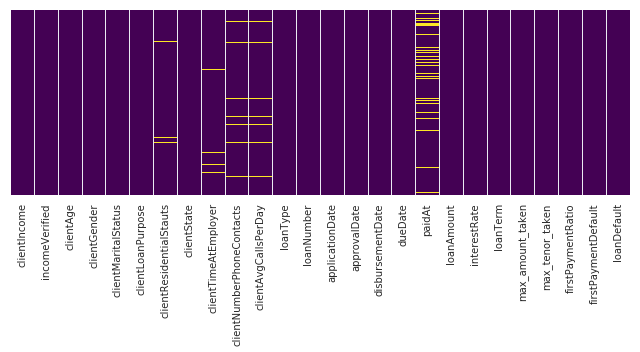

In [ ]:
plt.figure(figsize=(9,5))
sns.heatmap(data.isnull(),yticklabels=False,cbar=False,cmap='viridis')
plt.tight_layout()
# VIEW NULL VALUES ON A HEATMAP

Looking at the above data we can see the paidAt column has alot of null values ,so it tends to be less relevant therefore we drop the column

In [ ]:
data.drop('paidAt',inplace=True,axis=1)

In [ ]:
data['clientResidentialStauts'].isna().sum() 

1136

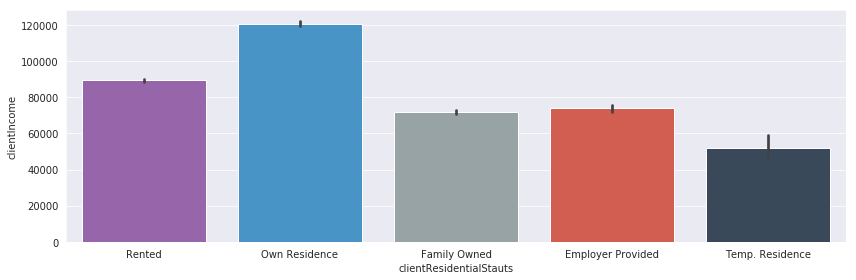

In [ ]:
plt.figure(figsize=(12,4))
sns.barplot(x=data['clientResidentialStauts'],y=data['clientIncome'])
plt.tight_layout()

now let's fill null client residence based off on thier income ,in the above we can see those with higher income tends to own a residence followed by the rented then others

In [ ]:
def fillResidence(cols):
    residence = cols[0]
    income= cols[1]
    if pd.isnull(residence):
        if income > 89000:
            return 'Own Residence'
        elif income >73000:
            return 'Rented'
        elif income >71000: 
            return 'Employer Provided'
        elif income >=51_000:
            return 'Family Owned'
        elif income <51_000:
            return 'Temp. Residence'
        else:
            return 'Rented' #because rented is majority(count)so if there's no option that matches the above we pick rented
    else:
        return residence

In [ ]:
data['clientResidentialStauts']= data[['clientResidentialStauts','clientIncome']].apply(fillResidence,axis=1)

lets handle the average call per day, we can impute the mean value to the null values

In [ ]:
data['clientAvgCallsPerDay'] = data['clientAvgCallsPerDay'].astype(float)

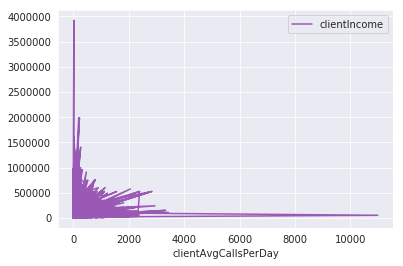

In [ ]:
data.plot(x='clientAvgCallsPerDay',y='clientIncome')

from the above we can see the income doesnt really correlate with clientavgcallsperday so we therefore stick to the mean

In [ ]:
from sklearn.preprocessing import Imputer

In [ ]:
data['clientAvgCallsPerDay']= Imputer(missing_values="NaN",\
                                      strategy="mean",axis = 0).fit_transform(data[['clientAvgCallsPerDay']])

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:58: DeprecationWarning:

Class Imputer is deprecated; Imputer was deprecated in version 0.20 and will be removed in 0.22. Import impute.SimpleImputer from sklearn instead.



in incomeverfied and clientSTATE maritalstatus we can fill the null value with the most frequent value

In [ ]:
data['incomeVerified'].fillna(value=data['incomeVerified'].value_counts().index[0],inplace = True)

In [ ]:
data['clientState'].fillna(value=data['clientState'].value_counts().index[0],inplace = True)

In [ ]:
data['clientMaritalStatus'].fillna(value=data['clientMaritalStatus'].value_counts().index[0],inplace = True)

fill clientNumberPhoneContacts with the mean value

In [ ]:
data['clientNumberPhoneContacts'] = data['clientNumberPhoneContacts'].astype(float) 

In [ ]:
data['clientNumberPhoneContacts']= Imputer(missing_values="NaN",
                                      strategy="mean",axis = 0).fit_transform(data[['clientNumberPhoneContacts']])

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:58: DeprecationWarning:

Class Imputer is deprecated; Imputer was deprecated in version 0.20 and will be removed in 0.22. Import impute.SimpleImputer from sklearn instead.



now for clients time at employer let's see what we can fill it with

In [ ]:
data['clientNumberPhoneContacts'] = data['clientNumberPhoneContacts'].astype(int)

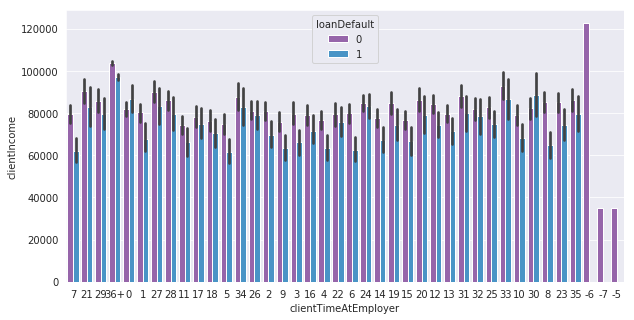

In [ ]:
plt.figure(figsize=(10,5))
sns.barplot(x =data['clientTimeAtEmployer'],y= data['clientIncome'],hue=data['loanDefault'] )

based on the above client time at employe doesnt really determine whether a loan will be defualted so therefore is irrelevant

In [ ]:
data.drop('clientTimeAtEmployer',axis = 1,inplace=True)

In [ ]:
data.isna().sum()

clientIncome                 0
incomeVerified               0
clientAge                    0
clientGender                 0
clientMaritalStatus          0
clientLoanPurpose            0
clientResidentialStauts      0
clientState                  0
clientNumberPhoneContacts    0
clientAvgCallsPerDay         0
loanType                     0
loanNumber                   0
applicationDate              0
approvalDate                 0
disbursementDate             0
dueDate                      0
loanAmount                   0
interestRate                 0
loanTerm                     0
max_amount_taken             0
max_tenor_taken              0
firstPaymentRatio            0
firstPaymentDefault          0
loanDefault                  0
dtype: int64

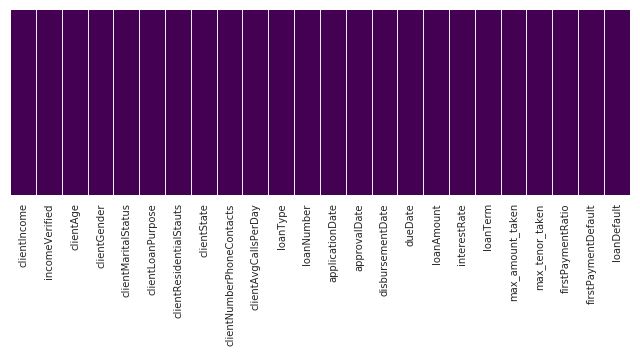

In [ ]:
plt.figure(figsize=(9,5))
sns.heatmap(data.isnull(),yticklabels=False,cbar=False,cmap='viridis')
plt.tight_layout()

### WE ARE DONE WITH MISSING DATA LET'S MOVE TO **EDA**



In [ ]:
data.to_csv('short1.csv',index=False)

In [ ]:
data = pd.read_csv('short1.csv')

In [ ]:
data.head()

,clientIncome,incomeVerified,clientAge,clientGender,clientMaritalStatus,clientLoanPurpose,clientResidentialStauts,clientState,clientNumberPhoneContacts,clientAvgCallsPerDay,...,disbursementDate,dueDate,loanAmount,interestRate,loanTerm,max_amount_taken,max_tenor_taken,firstPaymentRatio,firstPaymentDefault,loanDefault
0,52500.0,False,29,FEMALE,Single,business,Rented,KANO,257,153.000000,...,2018-07-12,2018-09-10 06:35:11 UTC,16000,20.0,60,1,1,0.0,0,0
1,52500.0,False,25,MALE,Single,business,Rented,LAGOS,3964,269.426415,...,2018-08-22,2018-10-21 07:13:29 UTC,14500,15.0,60,0,1,0.0,0,0
2,35000.0,False,32,MALE,Single,education,Rented,ANAMBRA,1140,77.147826,...,2018-08-25,2018-10-23 11:00:00 UTC,19500,15.0,60,0,1,0.0,1,1
3,35000.0,False,28,FEMALE,Married,business,Own Residence,OSUN,2764,31.678112,...,2018-06-19,2018-08-18 04:21:05 UTC,19500,15.0,60,1,1,0.0,0,0
4,35000.0,False,34,MALE,Married,medical,Rented,ONDO,504,3.000000,...,2018-06-02,2018-08-01 07:31:40 UTC,17500,12.5,60,1,1,0.0,1,1


let's explore on the application date aprroval data and disburment date

In [ ]:
data['applicationDate'] = pd.to_datetime(data['applicationDate'])
data['approvalDate'] = pd.to_datetime(data['approvalDate'])
data['disbursementDate'] = pd.to_datetime(data['disbursementDate'])

In [ ]:
dmap = {0:'Mon',1:'Tue',2:'Wed',3:'Thu',4:'Fri',5:'Sat',6:'Sun'}

In [ ]:
data['ApplicationMonth'] =data['applicationDate'].apply(lambda M: M.month) 
data['ApplicationDOW'] =data['applicationDate'].apply(lambda D: D.dayofweek).map(dmap)

###############################################
data['ApprovalMonth'] =data['approvalDate'].apply(lambda M: M.month) 
data['ApprovalDOW'] =data['approvalDate'].apply(lambda D: D.dayofweek).map(dmap)

##############################################
data['disbursementMonth'] =data['disbursementDate'].apply(lambda M: M.month) 
data['disbursementDOW'] =data['disbursementDate'].apply(lambda D: D.dayofweek).map(dmap)

now let's see what month had lot's of application for loans

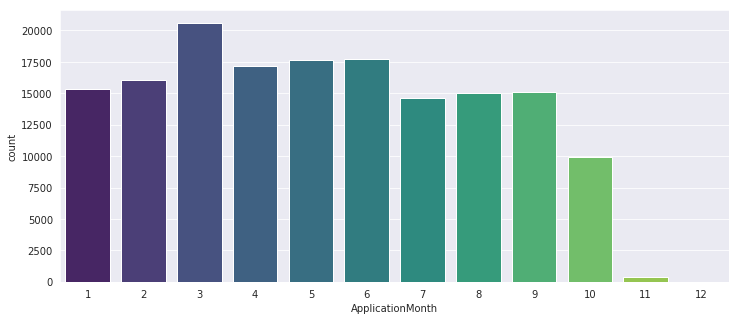

In [ ]:
plt.figure(figsize=(12,5))
sns.countplot(data['ApplicationMonth'],palette='viridis')

Based on the above we can see that during the 11th and 12th month pple don't really apply for a loan

now let's see what month had lot's of approval of loans

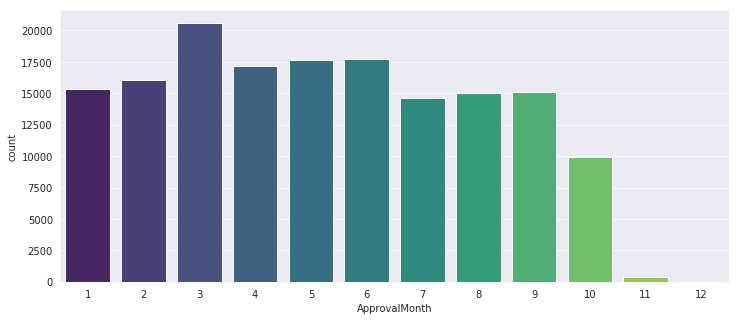

In [ ]:
plt.figure(figsize=(12,5))
sns.countplot(data['ApprovalMonth'],palette='viridis')

the aprroval month tends to tally with the application month

next is disburment date

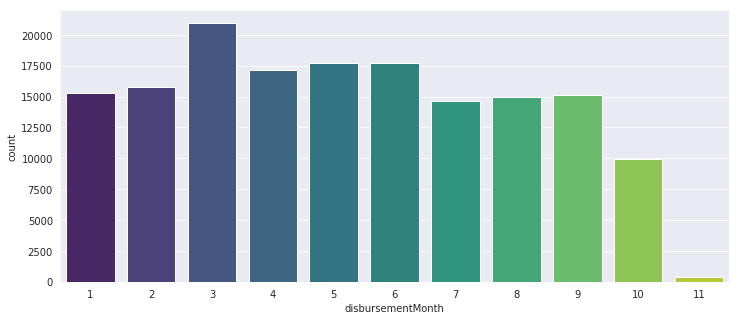

In [ ]:
plt.figure(figsize=(12,5))
sns.countplot(data['disbursementMonth'],palette='viridis')

all the dates seems to be operating under the same influence and are related so let's focus on more exploration of the application date

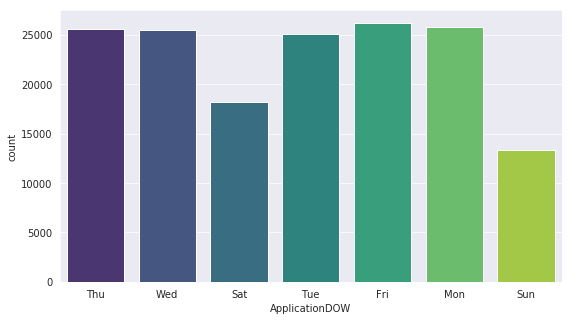

In [ ]:
plt.figure(figsize=(9,5))
sns.countplot(data['ApplicationDOW'],palette='viridis')

In [ ]:
byApplicationMonth = data.groupby('ApplicationMonth').count()['loanDefault']

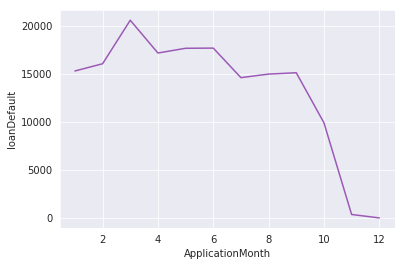

In [ ]:
sns.lineplot(x='ApplicationMonth',y='loanDefault',data=byApplicationMonth.reset_index())

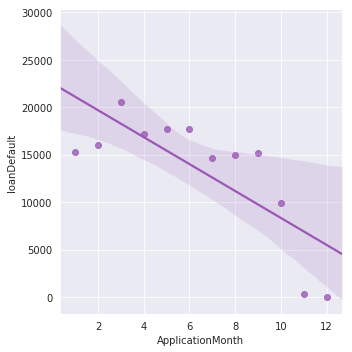

In [ ]:
sns.lmplot(x='ApplicationMonth',y='loanDefault',data=byApplicationMonth.reset_index())

In [ ]:
byApplicationDOW = data.groupby(['ApplicationDOW','loanDefault']).count()['ApprovalDOW'].unstack()
# i used approval DOW because the count is the same with application dow

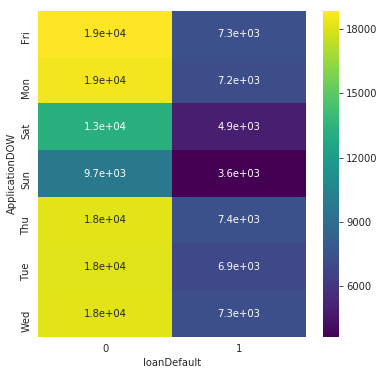

In [ ]:
plt.figure(figsize=(6,6))
sns.heatmap(byApplicationDOW,cmap='viridis',annot=True)

from the above we can see that loan repaid(0) beats default(1) in all day of the weak

WE are done with the dates let's take them down

In [ ]:
data.drop(['ApplicationMonth','ApplicationDOW','ApprovalMonth','ApprovalDOW','applicationDate','disbursementMonth','disbursementDOW',\
           'approvalDate','dueDate','disbursementDate','loanType'],axis=1,inplace=True)

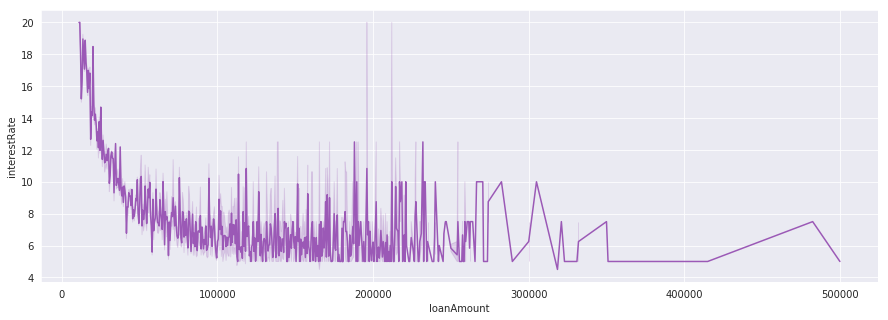

In [ ]:
plt.figure(figsize=(15,5))
sns.lineplot(data['loanAmount'],data['interestRate'])

looking at the above the interest rate decreases relative to loanAmount

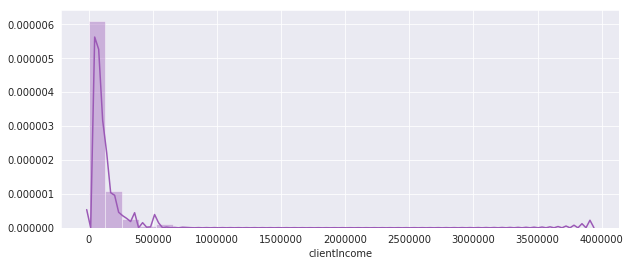

In [ ]:
plt.figure(figsize=(10,4))
sns.distplot(data['clientIncome'],bins=30)

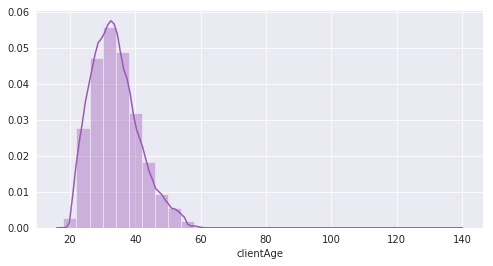

In [ ]:
plt.figure(figsize=(8,4))
sns.distplot(data['clientAge'],bins=30)

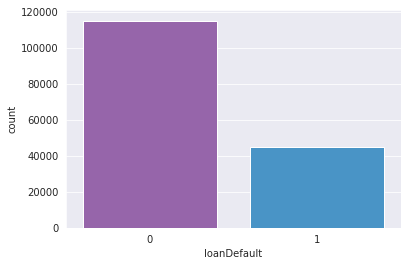

In [ ]:
sns.countplot(data['loanDefault'])

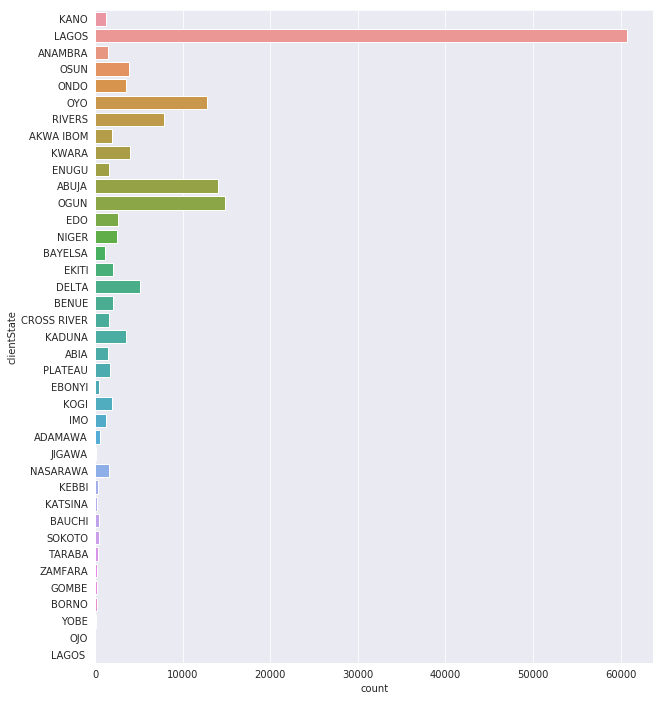

In [ ]:
plt.figure(figsize=(10,12))
sns.countplot(y=data['clientState'])

we can see lagos people are our major clients... also a lagos loan appeard twice in one of the rows let's match them up together

In [ ]:
data.loc[146864,'clientState'] = 'LAGOS'

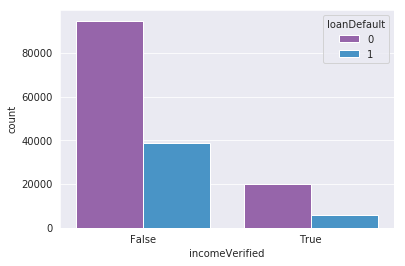

In [ ]:
sns.countplot(data['incomeVerified'],hue= data['loanDefault'])

based on  the above plot alot of income's that are not verified thier loan still be defaulted

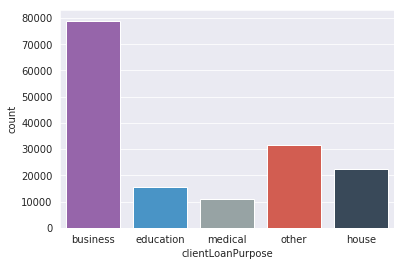

In [ ]:
sns.countplot(data['clientLoanPurpose'])

base on the above plot we can see that business people takes more loans than others

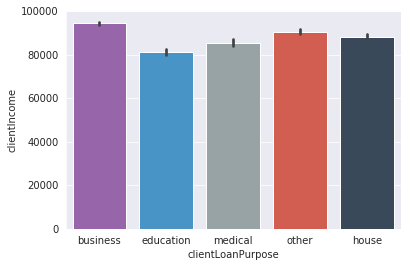

In [ ]:
sns.barplot(x= data['clientLoanPurpose'],y=data['clientIncome'])

this shows that the slaray of people who takes a loan doesnt really depend on the purpose of borrowing a loan,therefore we don't judge a client by purpose of his/her loan

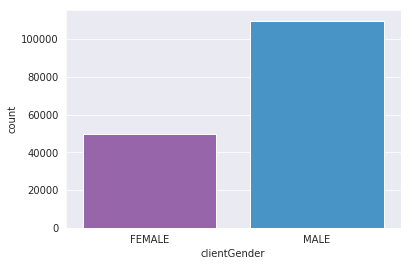

In [ ]:
sns.countplot(data['clientGender'])

boom it's the male domination in taking a loan

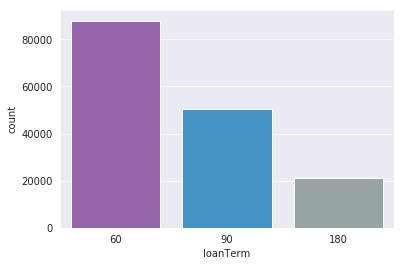

In [ ]:
sns.countplot(data['loanTerm'])

a 60 days loan term seems to be major

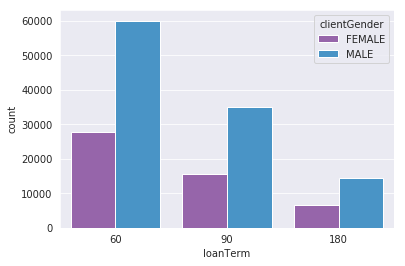

In [ ]:
sns.countplot(data['loanTerm'],hue= data['clientGender'])

as usual male again having population in the loanTerm category

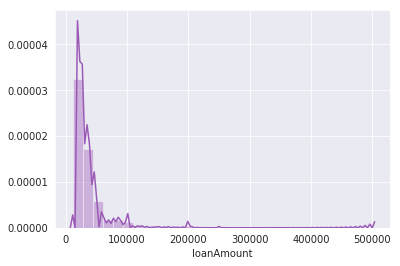

In [ ]:
sns.distplot(data['loanAmount'],bins=30)

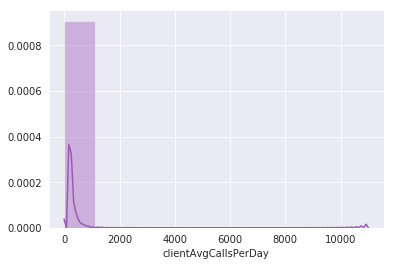

In [ ]:
sns.distplot(data['clientAvgCallsPerDay'],bins=10)

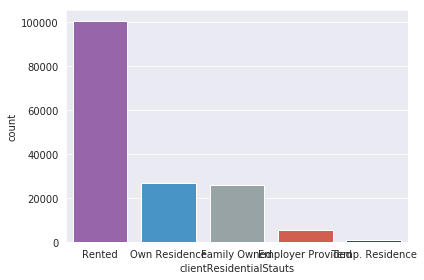

In [ ]:
sns.countplot(data['clientResidentialStauts'])
plt.tight_layout()

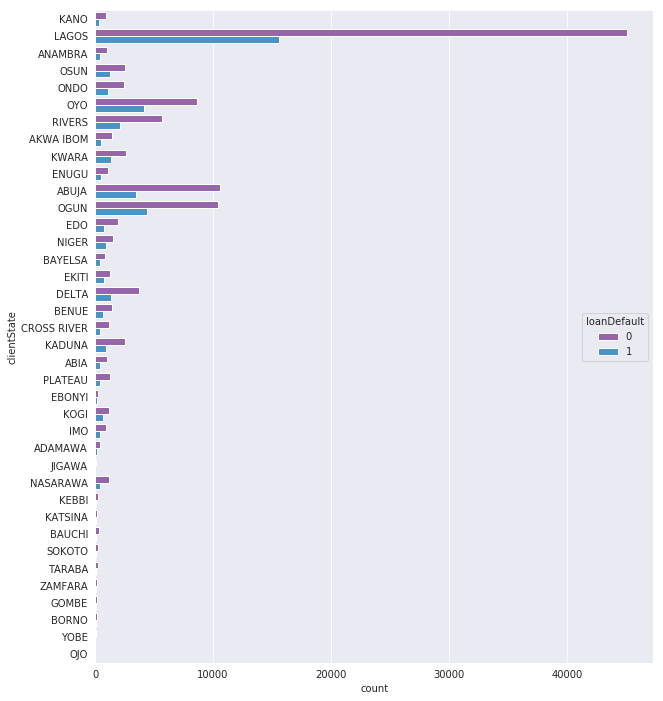

In [ ]:
plt.figure(figsize=(10,12))
sns.countplot(y=data['clientState'],hue= data['loanDefault'])

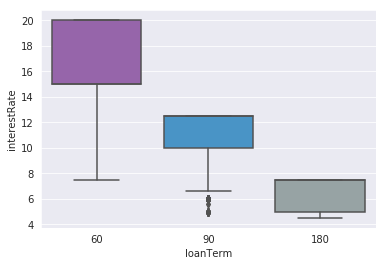

In [ ]:
sns.boxplot(x= data['loanTerm'],y=data['interestRate'])

from this above plot the lower the loan term the higher teh interest rate

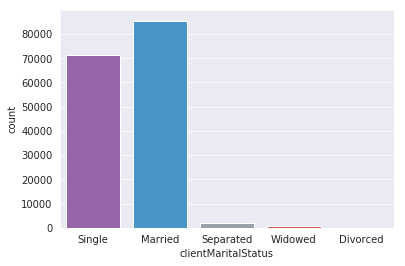

In [ ]:
sns.countplot(data['clientMaritalStatus'])

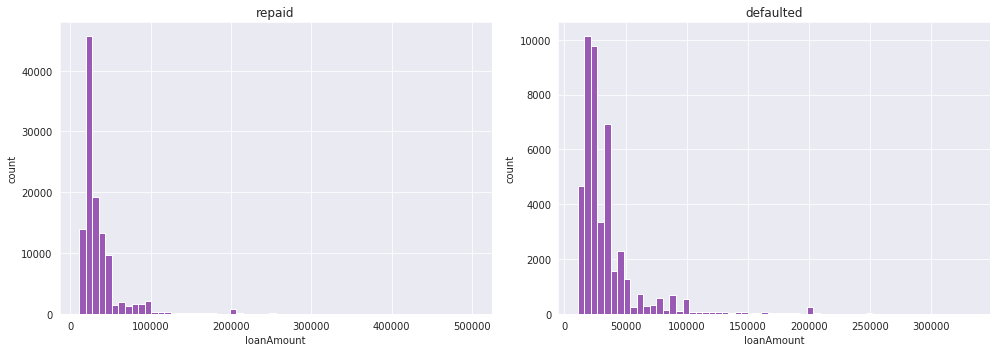

In [ ]:
fig,newAxes = plt.subplots(nrows = 1, ncols = 2,figsize=(14,5)) #this arranges it in rows and colums
newAxes[0].hist(data[(data['loanDefault']==0)]['loanAmount'],bins= 60)
newAxes[0].set_xlabel('loanAmount')
newAxes[0].set_ylabel('count')
newAxes[0].set_title('repaid')

newAxes[1].hist(data[(data['loanDefault']==1)]['loanAmount'],bins=60)
newAxes[1].set_xlabel('loanAmount')
newAxes[1].set_ylabel('count')
newAxes[1].set_title('defaulted')

#incase of overlappig we use
plt.tight_layout()

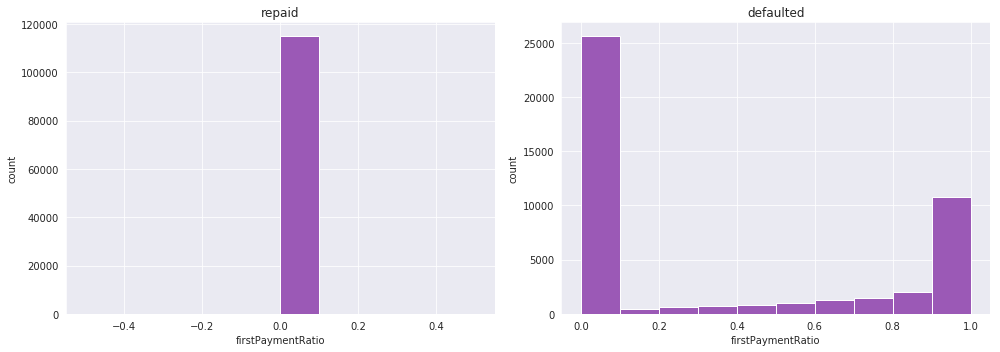

In [ ]:
fig,newAxes = plt.subplots(nrows = 1, ncols = 2,figsize=(14,5)) #this arranges it in rows and colums
newAxes[0].hist(data[(data['loanDefault']==0)]['firstPaymentRatio'])
newAxes[0].set_xlabel('firstPaymentRatio')
newAxes[0].set_ylabel('count')
newAxes[0].set_title('repaid')

newAxes[1].hist(data[(data['loanDefault']==1)]['firstPaymentRatio'])
newAxes[1].set_xlabel('firstPaymentRatio')
newAxes[1].set_ylabel('count')
newAxes[1].set_title('defaulted')

#incase of overlappig we use
plt.tight_layout()

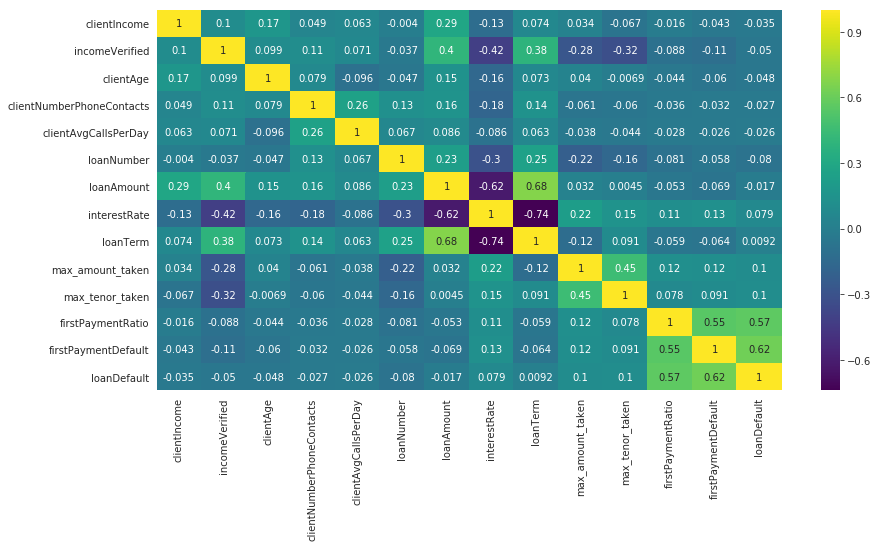

In [ ]:
plt.figure(figsize=(14,7))
sns.heatmap(data.corr(),annot=True,cmap='viridis')

checking out the Correlation of the variables

#### CONVERT CATEGORICAL COLUMNS TO  ONE HOT ENCODING AND DUMMY VARIABLES

In [ ]:
data.head()

,clientIncome,incomeVerified,clientAge,clientGender,clientMaritalStatus,clientLoanPurpose,clientResidentialStauts,clientState,clientNumberPhoneContacts,clientAvgCallsPerDay,loanNumber,loanAmount,interestRate,loanTerm,max_amount_taken,max_tenor_taken,firstPaymentRatio,firstPaymentDefault,loanDefault
0,52500.0,False,29,FEMALE,Single,business,Rented,KANO,257,153.000000,6,16000,20.0,60,1,1,0.0,0,0
1,52500.0,False,25,MALE,Single,business,Rented,LAGOS,3964,269.426415,9,14500,15.0,60,0,1,0.0,0,0
2,35000.0,False,32,MALE,Single,education,Rented,ANAMBRA,1140,77.147826,2,19500,15.0,60,0,1,0.0,1,1
3,35000.0,False,28,FEMALE,Married,business,Own Residence,OSUN,2764,31.678112,4,19500,15.0,60,1,1,0.0,0,0
4,35000.0,False,34,MALE,Married,medical,Rented,ONDO,504,3.000000,5,17500,12.5,60,1,1,0.0,1,1


In [ ]:
from sklearn.preprocessing import LabelEncoder

In [ ]:
label_Encoder = LabelEncoder()

In [ ]:
data['clientGender'] = label_Encoder.fit_transform(data['clientGender'])

In [ ]:
clientLoanPurpose = pd.get_dummies(data['clientLoanPurpose'],drop_first=True)

In [ ]:
data = pd.concat([clientLoanPurpose,data],axis=1)

now drop the columns we don't need

In [ ]:
data.drop(['clientLoanPurpose','clientMaritalStatus','clientResidentialStauts','incomeVerified',
           'clientAvgCallsPerDay','clientState','clientNumberPhoneContacts'],inplace=True,axis=1)

In [ ]:
data.head()

,education,house,medical,other,clientIncome,clientAge,clientGender,loanNumber,loanAmount,interestRate,loanTerm,max_amount_taken,max_tenor_taken,firstPaymentRatio,firstPaymentDefault,loanDefault
0,0,0,0,0,52500.0,29,0,6,16000,20.0,60,1,1,0.0,0,0
1,0,0,0,0,52500.0,25,1,9,14500,15.0,60,0,1,0.0,0,0
2,1,0,0,0,35000.0,32,1,2,19500,15.0,60,0,1,0.0,1,1
3,0,0,0,0,35000.0,28,0,4,19500,15.0,60,1,1,0.0,0,0
4,0,0,1,0,35000.0,34,1,5,17500,12.5,60,1,1,0.0,1,1


In [ ]:
len(data.columns)

16

### NOW OUR DATA IS READY TO BE BUILT AND TRAINED

#### TRAIN THE MODEL WITH RANDOM FOREST

In [ ]:
# first we split this before we Scale it
data.to_csv('short1_final.csv',index=False)
data = pd.read_csv('short1_final.csv')
from sklearn.model_selection import train_test_split,learning_curve
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import accuracy_score,recall_score,precision_score,f1_score

In [ ]:
X = data.drop('loanDefault',axis=1)
y = data['loanDefault']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
sc = StandardScaler()

In [ ]:
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=100)
rfc.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [ ]:
def draw_learning_curves(X, y, estimator, num_trainings):
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=None, n_jobs=-1, train_sizes=np.linspace(.1, 1.0, num_trainings))

    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    plt.grid()

    plt.title("Learning Curves")
    plt.xlabel("Training examples")
    plt.ylabel("Score")

    plt.plot(train_sizes,train_scores_mean, 'o-', color="g",
             label="Training score")
    plt.plot(train_sizes,test_scores_mean, 'o-', color="y",
             label="Cross-validation score")


    plt.legend(loc="best")


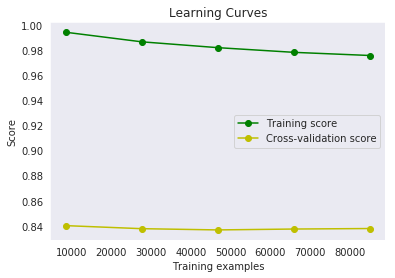

In [ ]:
draw_learning_curves(X_train,y_train,RandomForestClassifier(n_estimators=100),5)

In [ ]:
rfc_pred = rfc.predict(X_test)

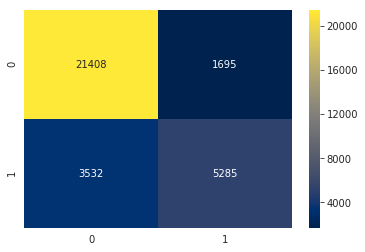

In [ ]:
cf = confusion_matrix(y_true=y_test,y_pred=rfc_pred)
sns.heatmap(cf,fmt ='g',annot=True,cmap = 'cividis')

In [ ]:
print(classification_report(y_test,rfc_pred))

              precision    recall  f1-score   support

           0       0.86      0.93      0.89     23103
           1       0.76      0.60      0.67      8817

   micro avg       0.84      0.84      0.84     31920
   macro avg       0.81      0.76      0.78     31920
weighted avg       0.83      0.84      0.83     31920



In [ ]:
print("accuracy",accuracy_score(y_test,rfc_pred))
print("\n")
print("precision",precision_score(y_test,rfc_pred))
print("\n")
print("recall",recall_score(y_test,rfc_pred))
print("\n")
print("f1_score",f1_score(y_test,rfc_pred,average='macro'))

accuracy 0.8362468671679198


precision 0.7571633237822349


recall 0.5994102302370421


f1_score 0.780158010339725


#### Tune the model using grid serach cv

In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
param_grid =  {'n_estimators': [75,150], 
              'max_features': ['log2', 'sqrt','auto'], 
              'criterion': ['entropy', 'gini'],
              'max_depth': [80, 90, 100], 
              'min_samples_split': [8, 10, 12],
              'min_samples_leaf': [1,5,8]
             }
# chooes params you want the model to work on and pick the best 

In [ ]:
rf = RandomForestClassifier()

In [ ]:
grid_search = GridSearchCV(estimator=rf,param_grid=param_grid,verbose=3,n_jobs=-1)

In [ ]:
grid_search.fit(X_train,y_train)

Fitting 3 folds for each of 324 candidates, totalling 972 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  28 tasks      | elapsed:  5.1min
[Parallel(n_jobs=-1)]: Done 124 tasks      | elapsed: 21.4min
[Parallel(n_jobs=-1)]: Done 284 tasks      | elapsed: 48.2min
[Parallel(n_jobs=-1)]: Done 508 tasks      | elapsed: 85.8min
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed: 130.5min
[Parallel(n_jobs=-1)]: Done 972 out of 972 | elapsed: 157.7min finished


GridSearchCV(cv='warn', error_score='raise-deprecating',
       estimator=RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators='warn', n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False),
       fit_params=None, iid='warn', n_jobs=-1,
       param_grid={'n_estimators': [75, 150], 'max_features': ['log2', 'sqrt', 'auto'], 'criterion': ['entropy', 'gini'], 'max_depth': [80, 90, 100], 'min_samples_split': [8, 10, 12], 'min_samples_leaf': [1, 5, 8]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=3)

In [ ]:
grid_search.best_params_

{'criterion': 'entropy',
 'max_depth': 100,
 'max_features': 'auto',
 'min_samples_leaf': 8,
 'min_samples_split': 8,
 'n_estimators': 150}

In [ ]:
grid_search.best_estimator_

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='entropy',
            max_depth=100, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=8, min_samples_split=8,
            min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [ ]:
grid_search.best_score_

0.851812400137849

In [ ]:
grid_pred = grid_search.predict(X_test)

In [ ]:
print(classification_report(y_test,grid_pred))

              precision    recall  f1-score   support

           0       0.86      0.94      0.90     23103
           1       0.80      0.61      0.69      8817

   micro avg       0.85      0.85      0.85     31920
   macro avg       0.83      0.78      0.80     31920
weighted avg       0.84      0.85      0.84     31920



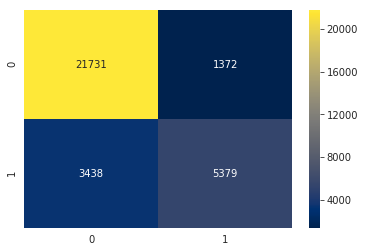

In [ ]:
cf = confusion_matrix(y_test,grid_pred)
sns.heatmap(cf,fmt ='g',annot=True,cmap = 'cividis')

In [ ]:
print("accuracy:",accuracy_score(y_test,grid_pred))
print("\n")
print("precision:",precision_score(y_test,grid_pred))
print("\n")
print("recall:",recall_score(y_test,grid_pred))
print("\n")
print("f1_score",f1_score(y_test,grid_pred,average='macro'))

accuracy: 0.8493107769423559


precision: 0.7967708487631462


recall: 0.6100714528751275


f1_score 0.7956946010973787


from what we studied this model performed well on repaid(0) and poorly on the defaulted(1), the tunning made the model perfrom a little better than the first model

the recall for 0 was 94% predicting 21731 correctly and 1372 incorrectly
the recall for 1 was 61% predicting 5379 correctly and 3438 incorrectly

### TRAIN THE MODEL WITH KERAS ARTIFICIAL NEURAL NETWORK

In [ ]:
data = pd.read_csv('short1_final.csv')
!pip install tensorflow=='1.12.0'

    100% |████████████████████████████████| 83.1MB 339kB/s 
    100% |████████████████████████████████| 3.1MB 11.4MB/s 
  Found existing installation: tensorboard 1.13.1
    Uninstalling tensorboard-1.13.1:
      Successfully uninstalled tensorboard-1.13.1
  Found existing installation: tensorflow 1.13.1
    Uninstalling tensorflow-1.13.1:
      Successfully uninstalled tensorflow-1.13.1


In [ ]:
X = data.drop('loanDefault',axis=1)
y = data['loanDefault']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

In [ ]:
from sklearn.preprocessing import MinMaxScaler

In [ ]:
ms  = MinMaxScaler()

In [ ]:
X_train = ms.fit_transform(X_train)
X_test = ms.transform(X_test)

In [ ]:
from tensorflow import keras
import tensorflow as tf
from tensorflow.keras.layers import Dense,Dropout,BatchNormalization
from tensorflow.keras import regularizers,backend
from tensorflow.keras.constraints import max_norm
from sklearn.metrics import roc_auc_score

In [ ]:
#add RUC metrics to monitor dnn
def auc(y_true,y_pred):
    auc =tf.metrics.auc(y_true,y_pred)[1]
    backend.get_session().run(tf.local_variables_initializer())
    return auc

In [ ]:
model = keras.Sequential([
    Dense(256,activation='relu',input_shape = [X_train.shape[1]],kernel_initializer = "normal",
          kernel_regularizer=regularizers.l2(0.005), # this model is being tuned using ridge regularizer
                kernel_constraint = max_norm(5)),
    Dropout(0.2),
    #BatchNormalization(),
    Dense(256,activation='relu', kernel_regularizer=regularizers.l2(0.005), 
                kernel_constraint = max_norm(5)),
    Dropout(0.1),
    #BatchNormalization(),
    Dense(128,activation='relu',kernel_regularizer=regularizers.l2(0.005), 
                kernel_constraint = max_norm(5)),
    Dropout(0.1),
    #BatchNormalization(),
    Dense(1,activation='sigmoid')
])

In [ ]:
model.compile(optimizer='rmsprop',
             loss='binary_crossentropy',
             metrics=['accuracy',auc])

In [ ]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 256)               4096      
_________________________________________________________________
dropout (Dropout)            (None, 256)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               65792     
_________________________________________________________________
dropout_1 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 128)               32896     
_________________________________________________________________
dropout_2 (Dropout)          (None, 128)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 129       
Total para

In [ ]:
np.random.seed(1)
tf.set_random_seed(2)# to prevent getting different values on regularization

In [ ]:
history = model.fit(X_train,y_train,validation_split=0.1,epochs=125,batch_size=10000)

Train on 114908 samples, validate on 12768 samples
Epoch 1/125
114908/114908 [==============================] - 5s 44us/step - loss: 2.2493 - acc: 0.7612 - auc: 0.6713 - val_loss: 1.7664 - val_acc: 0.8518 - val_auc: 0.7685
Epoch 2/125
114908/114908 [==============================] - 5s 40us/step - loss: 1.5902 - acc: 0.8421 - auc: 0.7977 - val_loss: 1.3584 - val_acc: 0.8519 - val_auc: 0.8120
Epoch 3/125
114908/114908 [==============================] - 5s 40us/step - loss: 1.2416 - acc: 0.8431 - auc: 0.8194 - val_loss: 1.0768 - val_acc: 0.8519 - val_auc: 0.8241
Epoch 4/125
114908/114908 [==============================] - 5s 40us/step - loss: 0.9877 - acc: 0.8446 - auc: 0.8273 - val_loss: 0.8698 - val_acc: 0.8519 - val_auc: 0.8301
Epoch 5/125
114908/114908 [==============================] - 5s 39us/step - loss: 0.8072 - acc: 0.8433 - auc: 0.8316 - val_loss: 0.7066 - val_acc: 0.8521 - val_auc: 0.8334
Epoch 6/125
114908/114908 [==============================] - 5s 39us/step - loss: 0.6748 

In [ ]:
test_loss , test_acc,auc  = model.evaluate(X_test,y_test)

31920/31920 [==============================] - 2s 60us/step


In [ ]:
print(test_acc)

0.8474937343358396


(0.32, 0.62)

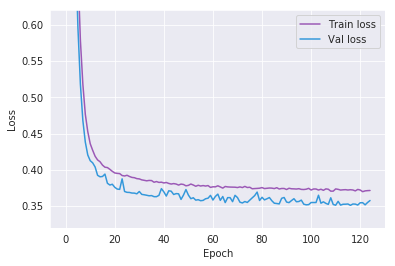

In [ ]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

plt.figure()
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.plot(hist['epoch'], hist['loss'],
           label='Train loss')
plt.plot(hist['epoch'], hist['val_loss'],
           label = 'Val loss')
plt.legend()
plt.ylim([0.32,0.62])

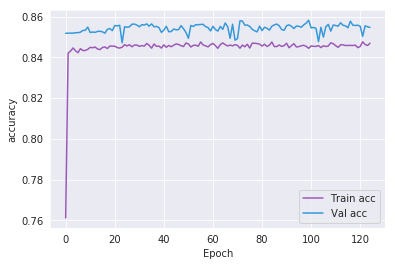

In [ ]:
plt.figure()
plt.xlabel('Epoch')
plt.ylabel('accuracy')
plt.plot(hist['epoch'], hist['acc'],
           label='Train acc')
plt.plot(hist['epoch'], hist['val_acc'],
           label = 'Val acc')
plt.legend()

In [ ]:
y_pred = model.predict_classes(X_test)

In [ ]:
cm = confusion_matrix(y_test, y_pred)
cr = classification_report(y_test, y_pred)

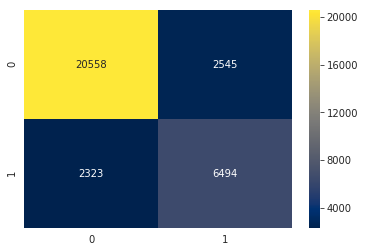

In [ ]:
sns.heatmap(cm,fmt ='g',annot=True,cmap = 'cividis')

In [ ]:
print(cr)

              precision    recall  f1-score   support

           0       0.90      0.89      0.89     23103
           1       0.72      0.74      0.73      8817

   micro avg       0.85      0.85      0.85     31920
   macro avg       0.81      0.81      0.81     31920
weighted avg       0.85      0.85      0.85     31920



In [ ]:
print(accuracy_score(y_test,y_pred))
print("\n")
print(precision_score(y_test,y_pred,average='macro'))
print("\n")
print(recall_score(y_test,y_pred,average='macro'))
print("\n")
print(f1_score(y_test,y_pred,average='macro'))

0.8474937343358396


0.8084585112894457


0.813186423148126


0.8107558215667348


### COMPARISON

comapring both model at training level

In [ ]:
print("the train accuracy for the RF model is",grid_search.best_score_)
print("\n")
print("the training accuracy for ANN model is",hist['acc'].iloc[-1])

the train accuracy for the RF model is 0.851812400137849


the training accuracy for ANN model is 0.8469645318727869


the model trained better on the RF model. but let's see how it peforms with unknown dataset(TEST SET)

In [ ]:
Compare = pd.DataFrame(data=None,columns=['RF','ANN'],index=['accuracy','precision-avg','recall-avg','f1_score-avg'])

In [ ]:
Compare.iloc[0,0] = accuracy_score(y_test,grid_pred)

In [ ]:
Compare.iloc[1,0] = precision_score(y_test,grid_pred,average='macro')

In [ ]:
Compare.iloc[2,0] = recall_score(y_test,grid_pred,average='macro')

In [ ]:
Compare.iloc[3,0] = f1_score(y_test,grid_pred,average='macro')

In [ ]:
Compare.iloc[0,1] = accuracy_score(y_test,y_pred)

In [ ]:
Compare.iloc[1,1] =precision_score(y_test,y_pred,average='macro')

In [ ]:
Compare.iloc[2,1] = recall_score(y_test,y_pred,average='macro')

In [ ]:
Compare.iloc[3,1] = f1_score(y_test,y_pred,average='macro')

In [ ]:
Compare.iplot()

my conclusion from what we've seen in the model is that the ANN pefromed better than the Random Forest model .
the ANN model handled the defaulted class (1) extreemly well when compared to the Random forest model
the ANN also handled the repaid class(0) a little poor than the random forest model

0 class : ANN  20558 correct ,  2545 incorrect

0 class: RF 21731 correct   1372 incorrect

1 class: ANN 2323 incorrect ,  6494 correct

1 class: RF 3438 incorrect, 5379 correct

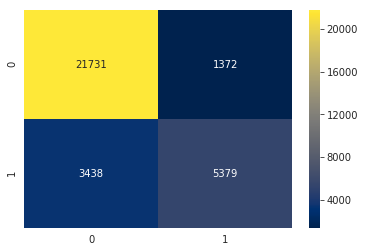

In [ ]:
cmrf = confusion_matrix(y_test,grid_pred) # for the RF
sns.heatmap(cmrf,fmt ='g',annot=True,cmap = 'cividis')

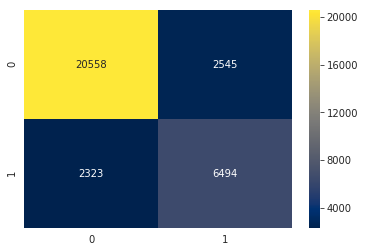

In [ ]:
 #for the ANN
  sns.heatmap(cm,fmt ='g',annot=True,cmap = 'cividis')

In [ ]:
Compare

,RF,ANN
accuracy,0.849311,0.847494
precision-avg,0.830087,0.808459
recall-avg,0.775343,0.813186
f1_score-avg,0.795695,0.810756
